In [1]:
if (!require("plotly")) install.packages("plotly")
library(plotly)

Loading required package: plotly
Loading required package: ggplot2

Attaching package: ‘plotly’

The following object is masked from ‘package:ggplot2’:

    last_plot

The following object is masked from ‘package:stats’:

    filter

The following object is masked from ‘package:graphics’:

    layout



In [2]:
if (!require("ggplot2")) install.packages("ggplot2")
library(ggplot2)

In [3]:
if (!require("psych")) install.packages("psych")
library(psych)

Loading required package: psych

Attaching package: ‘psych’

The following objects are masked from ‘package:ggplot2’:

    %+%, alpha



In [4]:
if (!require("rgl")) install.packages("rgl")
library(psych)

Loading required package: rgl
Warning message in library(package, lib.loc = lib.loc, character.only = TRUE, logical.return = TRUE, :
“there is no package called ‘rgl’”Warning message in install.packages("rgl"):
“installation of package ‘rgl’ had non-zero exit status”Updating HTML index of packages in '.Library'
Making 'packages.html' ... done


In [5]:
if (!require("RColorBrewer")) install.packages("RColorBrewer")
library(RColorBrewer)

Loading required package: RColorBrewer


In [6]:
if (!require("corrplot")) install.packages("corrplot")
library(corrplot)

Loading required package: corrplot
corrplot 0.84 loaded


In [7]:
if (!require("MASS")) install.packages("MASS")
library(MASS)

Loading required package: MASS

Attaching package: ‘MASS’

The following object is masked from ‘package:plotly’:

    select



In [8]:
if (!require("plot3D")) install.packages("plot3D")
library(MASS)

Loading required package: plot3D


In [9]:
if (!require("lattice")) install.packages("lattice")
library(lattice)

Loading required package: lattice


In [10]:
if (!require("reshape")) install.packages("reshape")
library(lattice)

Loading required package: reshape

Attaching package: ‘reshape’

The following object is masked from ‘package:plotly’:

    rename



# 1) ------------------------ Iris Dataset ------------------------

In [11]:
head(iris)

Sepal.Length,Sepal.Width,Petal.Length,Petal.Width,Species
5.1,3.5,1.4,0.2,setosa
4.9,3.0,1.4,0.2,setosa
4.7,3.2,1.3,0.2,setosa
4.6,3.1,1.5,0.2,setosa
5.0,3.6,1.4,0.2,setosa
5.4,3.9,1.7,0.4,setosa


In [12]:
head(Orange)

Tree,age,circumference
1,118,30
1,484,58
1,664,87
1,1004,115
1,1231,120
1,1372,142


In [13]:
head(mpg)

manufacturer,model,displ,year,cyl,trans,drv,cty,hwy,fl,class
audi,a4,1.8,1999,4,auto(l5),f,18,29,p,compact
audi,a4,1.8,1999,4,manual(m5),f,21,29,p,compact
audi,a4,2.0,2008,4,manual(m6),f,20,31,p,compact
audi,a4,2.0,2008,4,auto(av),f,21,30,p,compact
audi,a4,2.8,1999,6,auto(l5),f,16,26,p,compact
audi,a4,2.8,1999,6,manual(m5),f,18,26,p,compact


# 2) ------------------------ Scatter Plots ------------------------

## 2.1 -

In [14]:
?plot

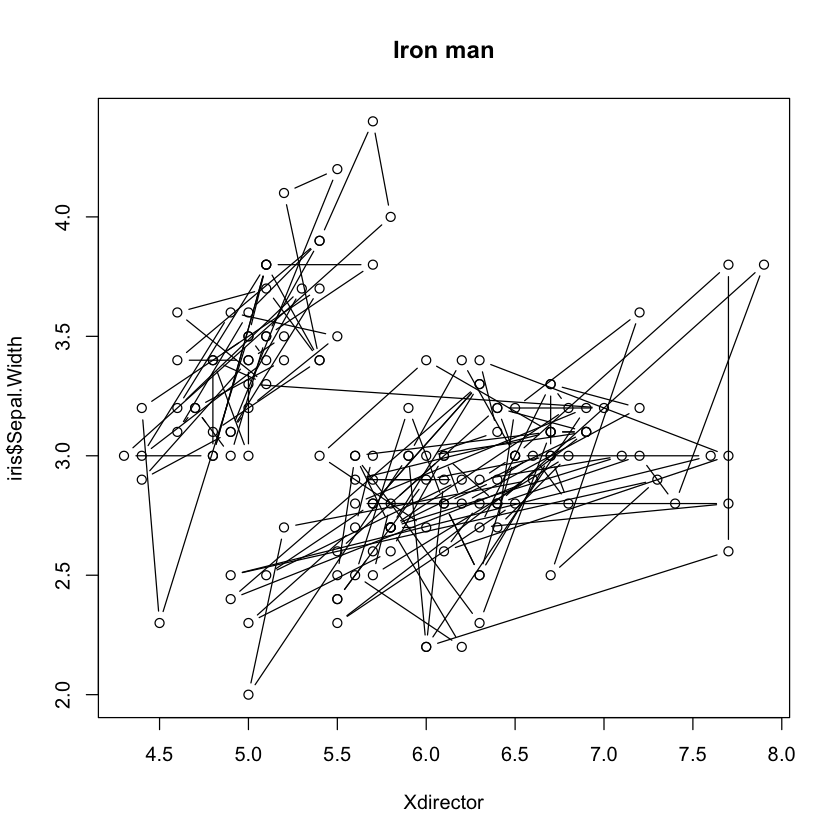

In [15]:
plot(iris$Sepal.Length, iris$Sepal.Width, pch=21, main="Iron man", type = "b", xlab = "Xdirector")

## 2.2 -


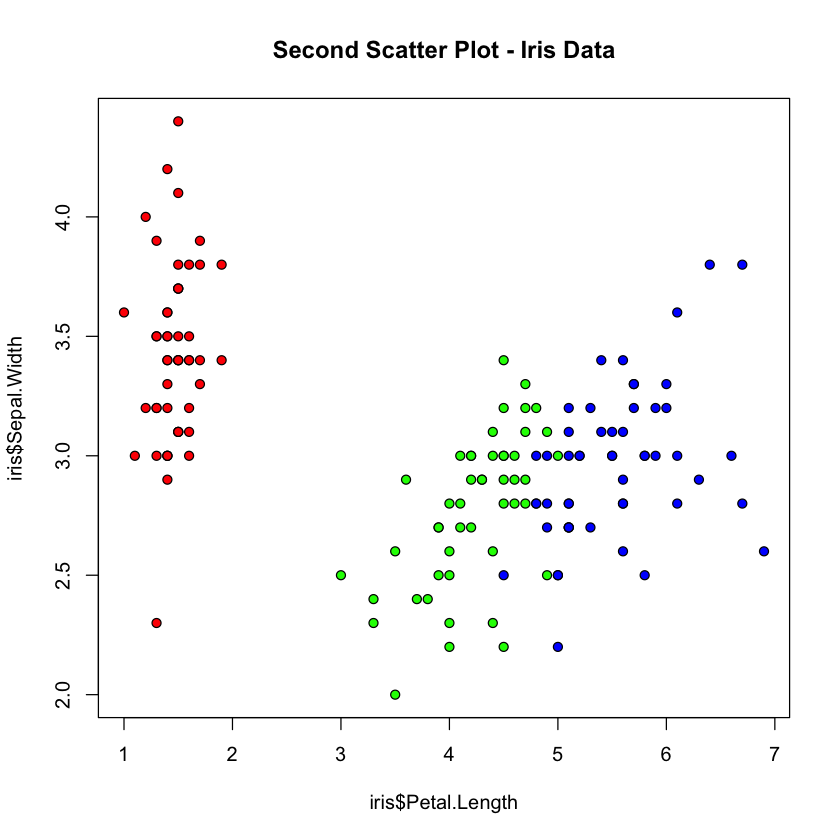

In [16]:
plot(iris$Petal.Length, iris$Sepal.Width, 
     pch=21, bg=c("red","green","blue")[unclass(iris$Species)], 
     main="Second Scatter Plot - Iris Data")


## 2.3 -


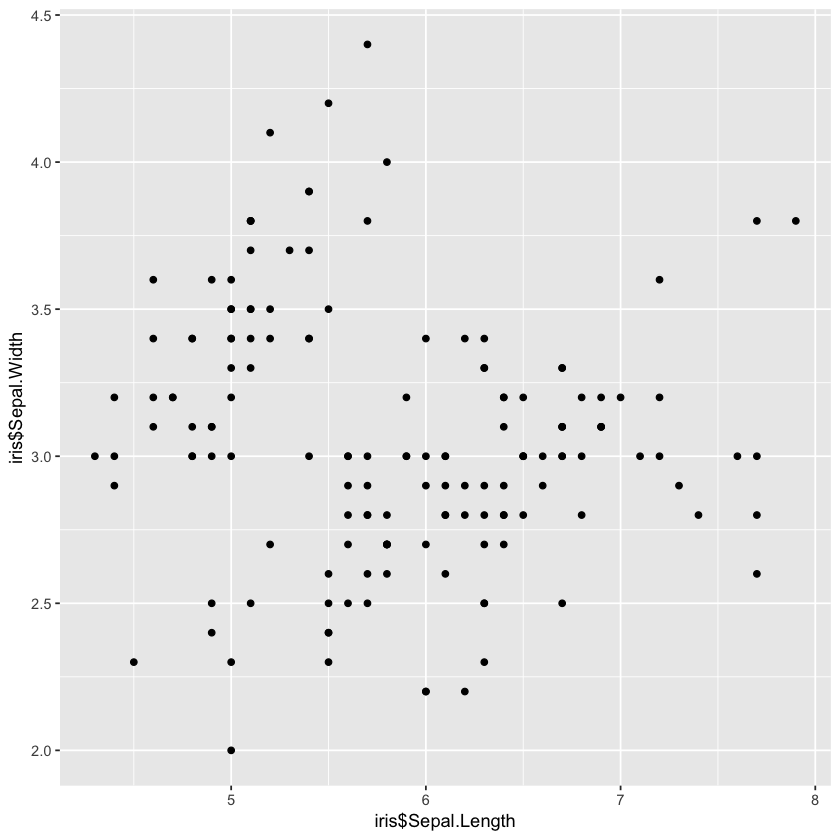

In [17]:
qplot(iris$Sepal.Length, iris$Sepal.Width)

## 2.4 -

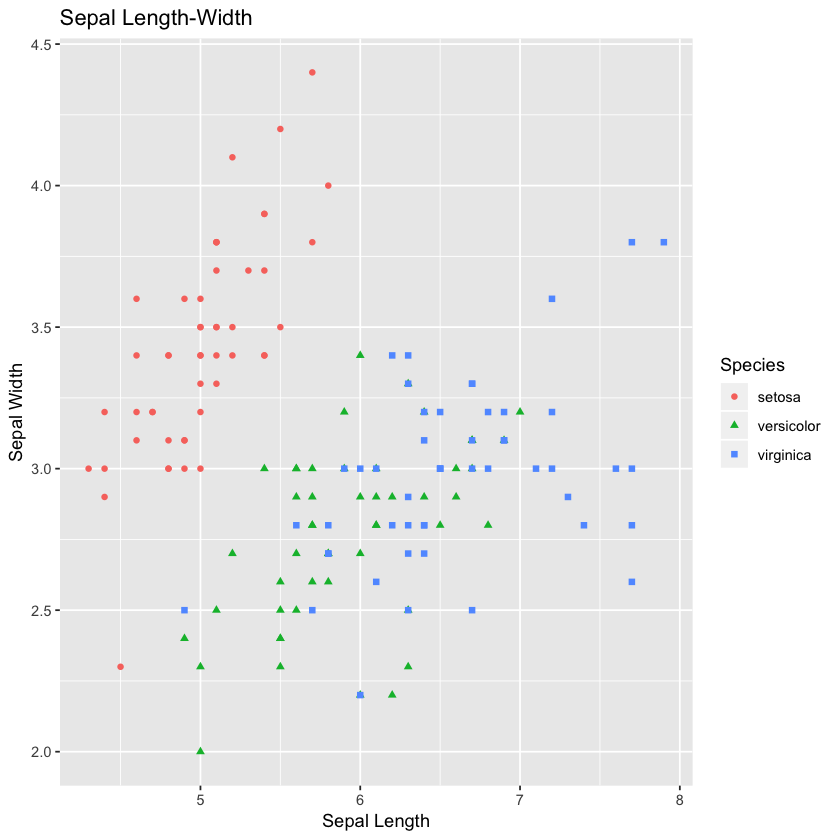

In [18]:
scatter <- ggplot(data=iris, aes(x = Sepal.Length, y = Sepal.Width)) 
scatter + geom_point(aes(color=Species, shape=Species)) +
  xlab("Sepal Length") +  ylab("Sepal Width") +
  ggtitle("Sepal Length-Width")

## 2.5 -

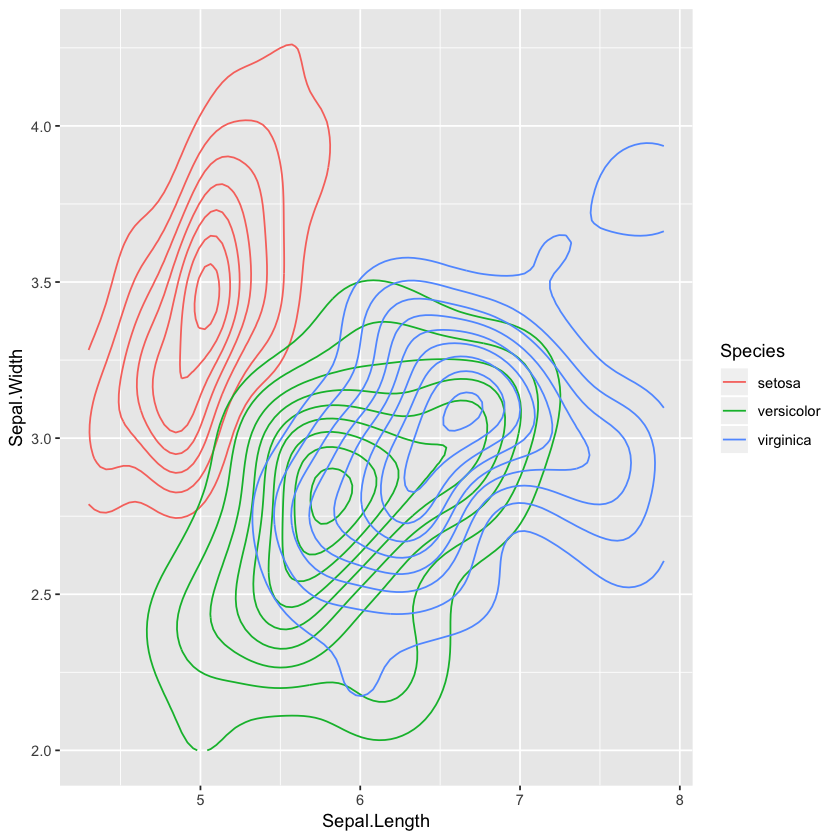

In [19]:
ggplot (iris, aes (x = Sepal.Length, y = Sepal.Width, colour = Species)) + stat_density2d ()

## 2.6 -

In [20]:
pal <- c("red", "blue", "green")
pal <- setNames(pal, c("virginica", "setosa", "versicolor"))
plot_ly(data = iris, x = ~Sepal.Length, y = ~Sepal.Width, color = ~Species, colors = pal)

No trace type specified:
  Based on info supplied, a 'scatter' trace seems appropriate.
  Read more about this trace type -> https://plot.ly/r/reference/#scatter
No scatter mode specifed:
  Setting the mode to markers
  Read more about this attribute -> https://plot.ly/r/reference/#scatter-mode


HTML widgets cannot be represented in plain text (need html)

## 2.7 - Plotly (3D interactive)

In [21]:
with(iris, plot_ly(iris, x = Sepal.Length, y= Petal.Length, z = Sepal.Width,
                  size = Petal.Width, color = Species,
                  type="scatter3d", mode="markers"))

Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“`line.width` does not currently support multiple values.”Warning message:
“`line.width` does not currently support multiple values.”

HTML widgets cannot be represented in plain text (need html)

## 2.8 scatterplot3d

In [22]:
if (!require("scatterplot3d")) install.packages("scatterplot3d")
library(scatterplot3d)

Loading required package: scatterplot3d


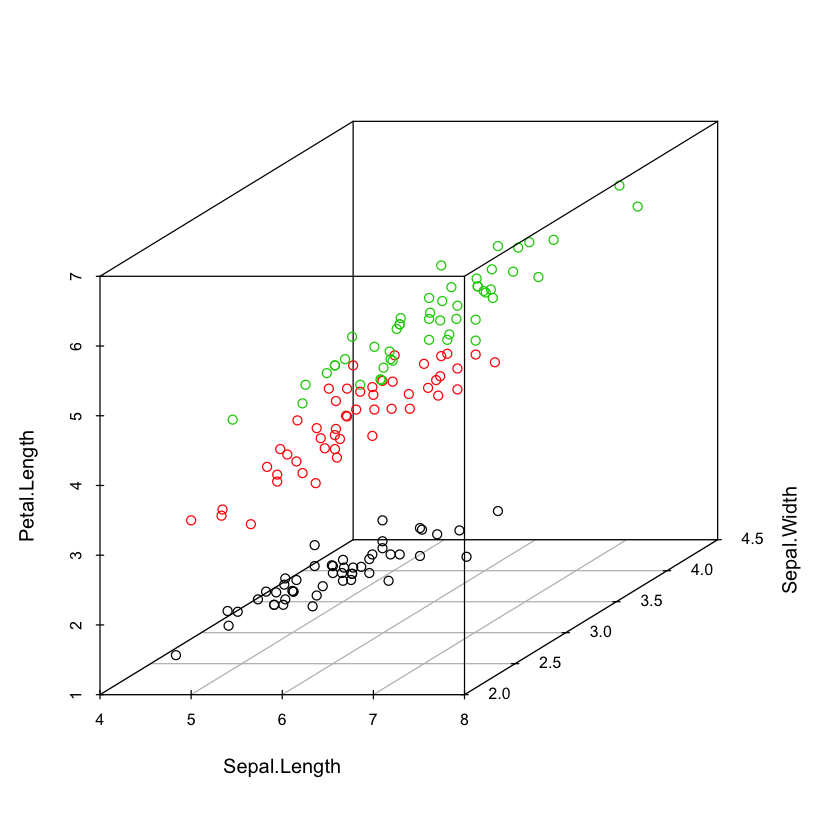

In [23]:
scatterplot3d(iris[,1:3], color=as.integer(iris$Species))

## 2.9 lattice

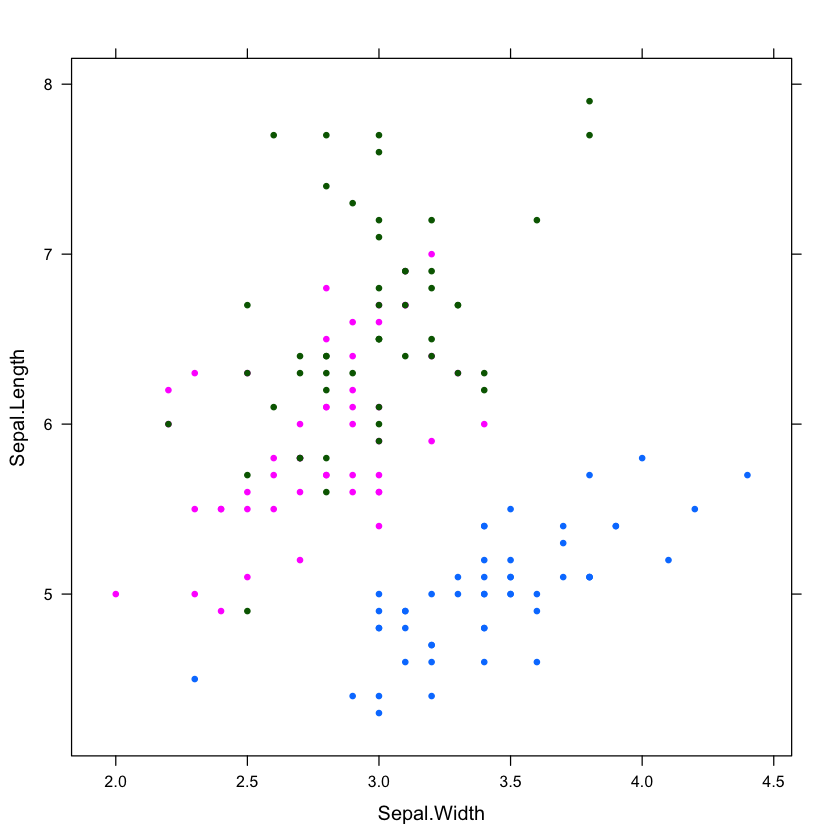

In [24]:
library(lattice)
xyplot(Sepal.Length ~ Sepal.Width, iris, groups = iris$Species, pch= 20)

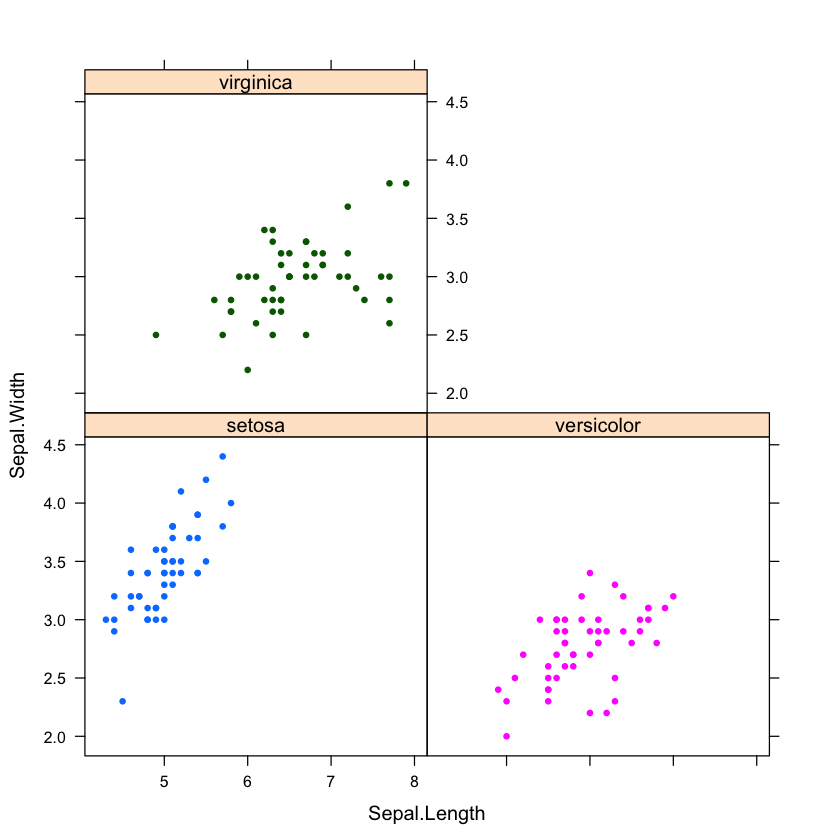

In [25]:
xyplot(Sepal.Width ~ Sepal.Length | Species, iris, groups = iris$Species, pch= 20)

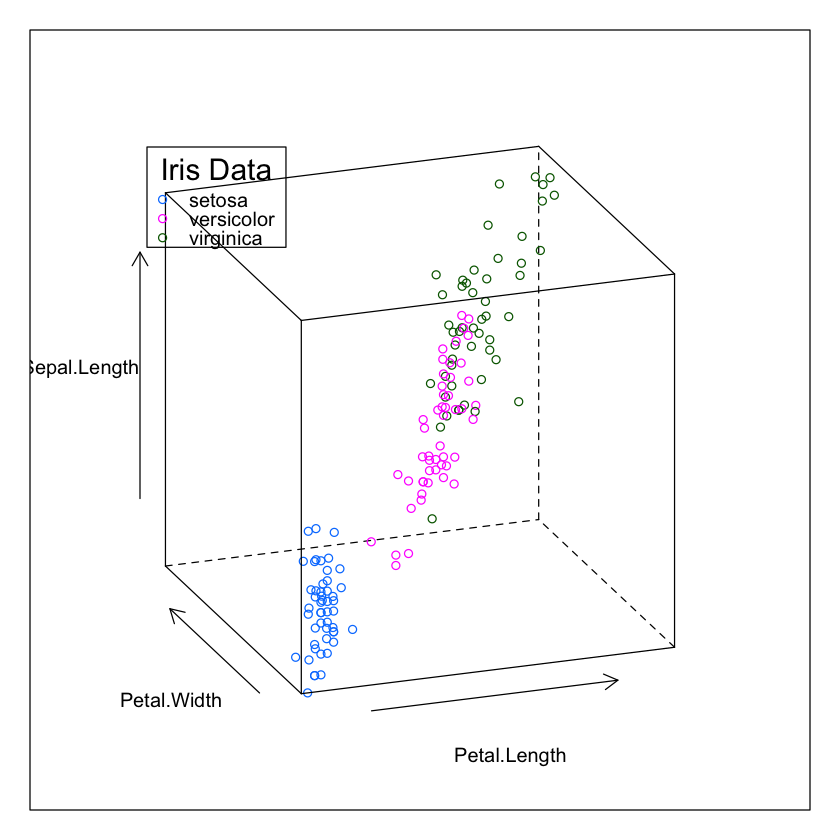

In [26]:
cloud(Sepal.Length ~ Petal.Length * Petal.Width, data = iris,
      groups = Species, screen = list(z = 20, x = -70),
      perspective = FALSE,
      key = list(title = "Iris Data", x = .15, y=.85, corner = c(0,1),
                 border = TRUE,
                 points = Rows(trellis.par.get("superpose.symbol"), 1:3),
                 text = list(levels(iris$Species))))

# 3) ------------------------ Pairwise Scatter Plots ------------------------
## 3.1 -- Basic R

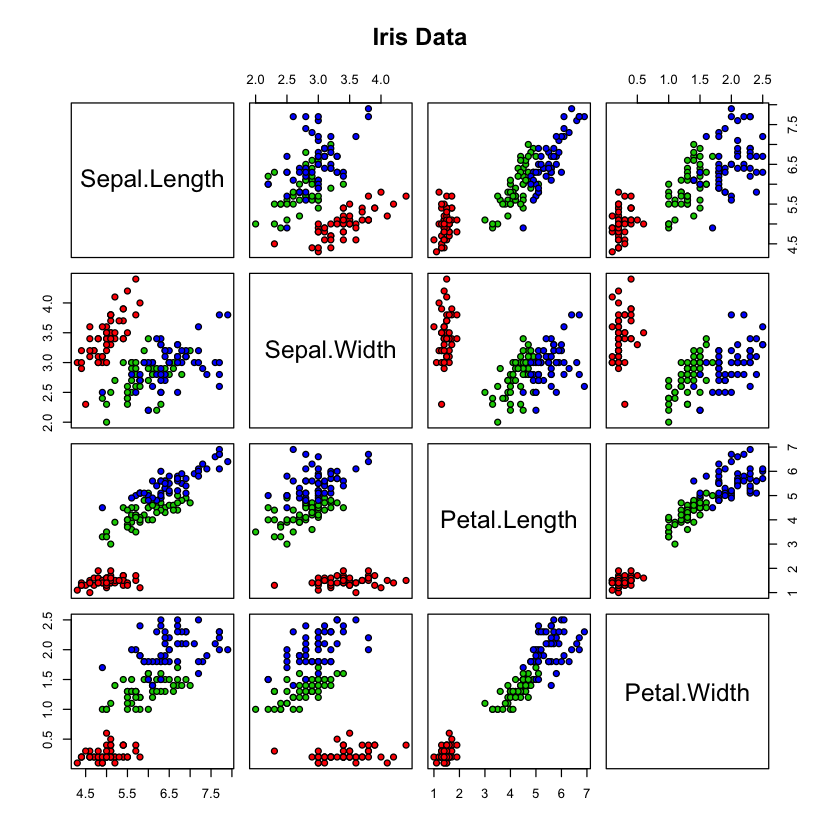

In [27]:
pairs(iris[1:4], main = "Iris Data", pch = 21, 
      bg = c("red", "green3", "blue")[unclass(iris$Species)])

## 3.2 -- Basic R

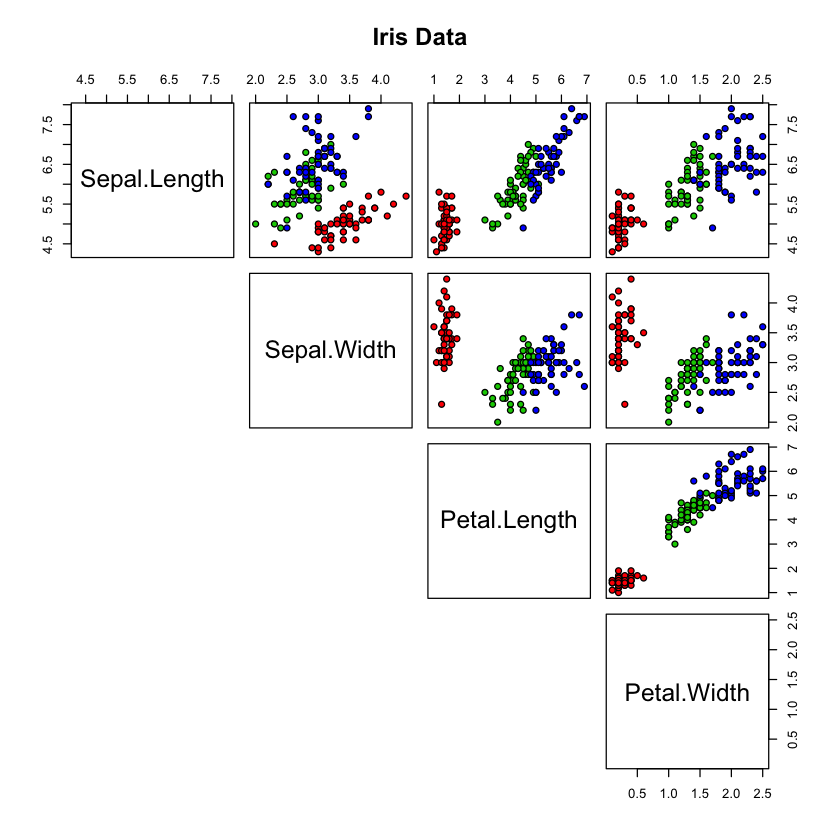

In [28]:
pairs(iris[1:4], main = "Iris Data", pch = 21, 
      bg = c("red", "green3", "blue")[unclass(iris$Species)],
      lower.panel = NULL)

## 3.3 -- Basic R 

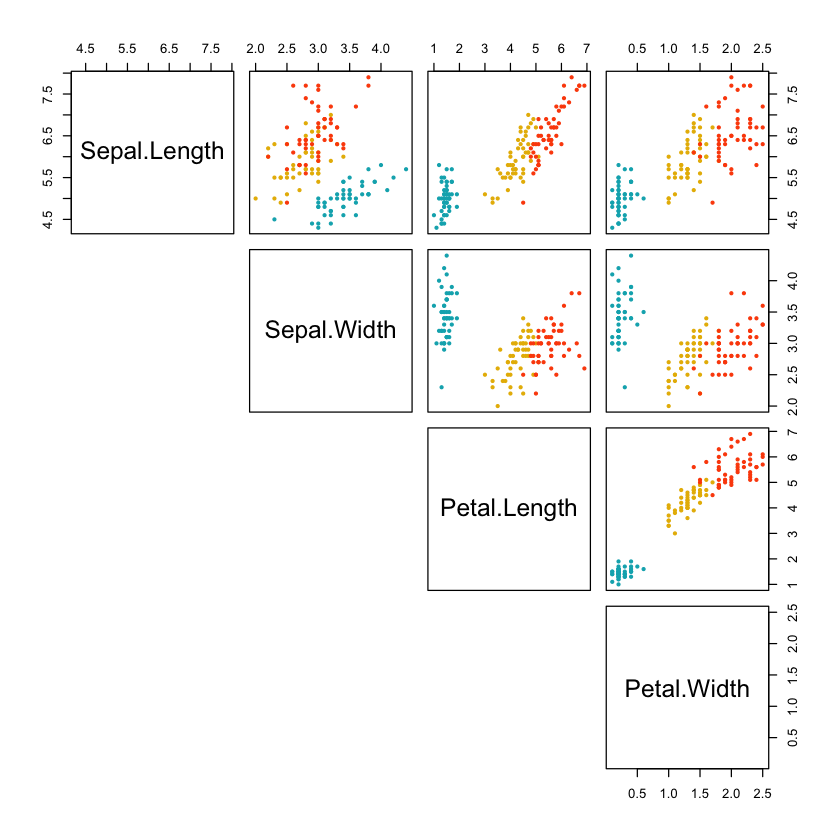

In [29]:
my_cols <- c("#00AFBB", "#E7B800", "#FC4E07")
pairs(iris[,1:4], pch = 19,  cex = 0.5,
      col = my_cols[iris$Species],
      lower.panel=NULL)

## 3.4 -- Basic R 

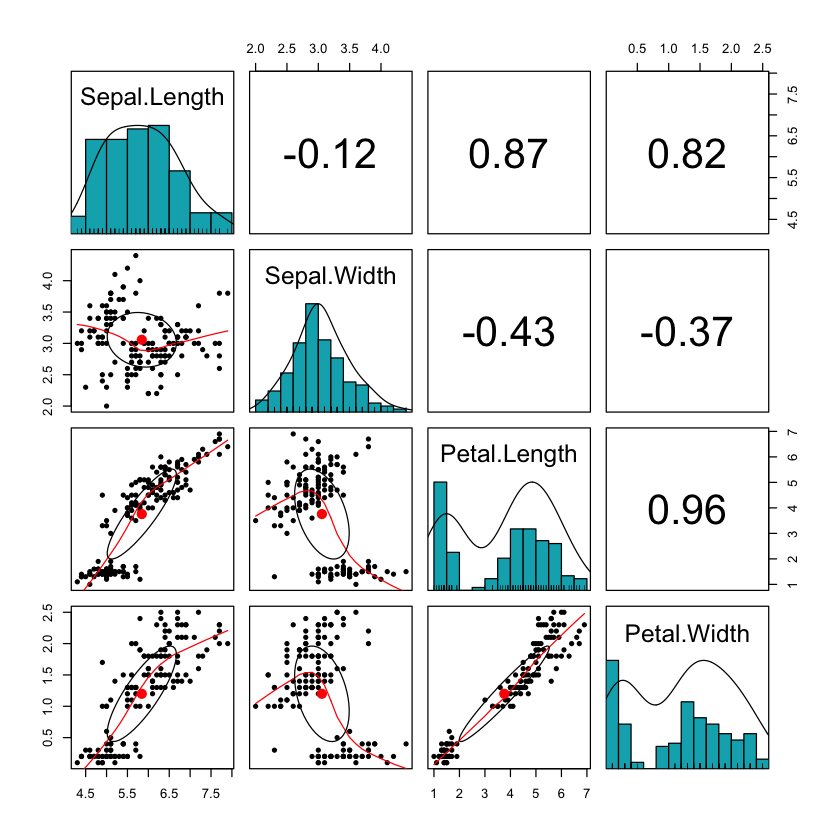

In [30]:
library(psych)
pairs.panels(iris[,-5], 
             method = "pearson", # correlation method
             hist.col = "#00AFBB",
             density = TRUE,  # show density plots
             ellipses = TRUE # show correlation ellipses
)

## 3.5 -- ggplot along columns 

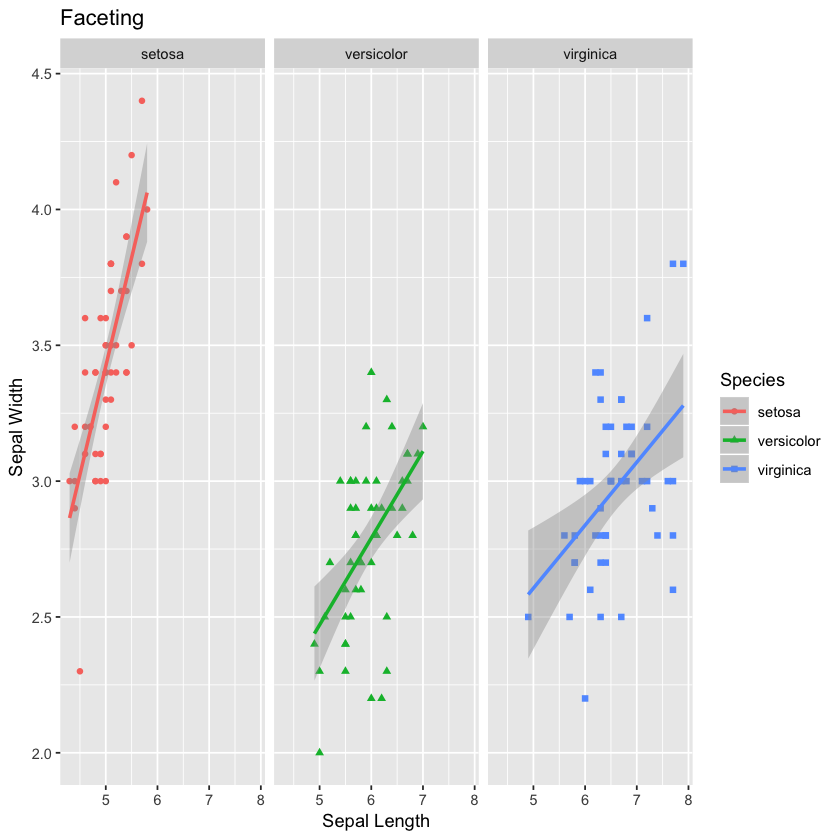

In [31]:
facet <- ggplot(data=iris, aes(Sepal.Length, y=Sepal.Width, color=Species)) + 
  geom_point(aes(shape=Species), size=1.5) + geom_smooth(method="lm") +
  xlab("Sepal Length") + ylab("Sepal Width") + ggtitle("Faceting")
# Along rows
facet + facet_grid(. ~ Species)

## 3.6 -- ggplot along rows 

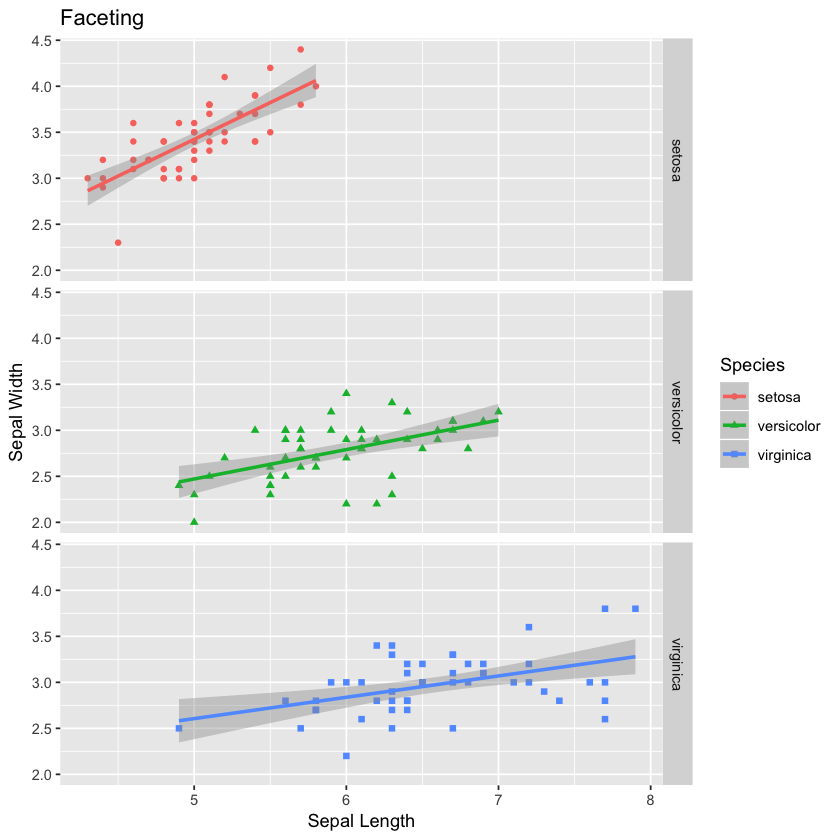

In [32]:
facet <- ggplot(data=iris, aes(Sepal.Length, y=Sepal.Width, color=Species)) + 
  geom_point(aes(shape=Species), size=1.5) + geom_smooth(method="lm") +
  xlab("Sepal Length") + ylab("Sepal Width") + ggtitle("Faceting")
# Along columns
facet + facet_grid(Species ~ .)

# 4) ------------------------ Histograms ------------------------
## 4.1 -- Base R


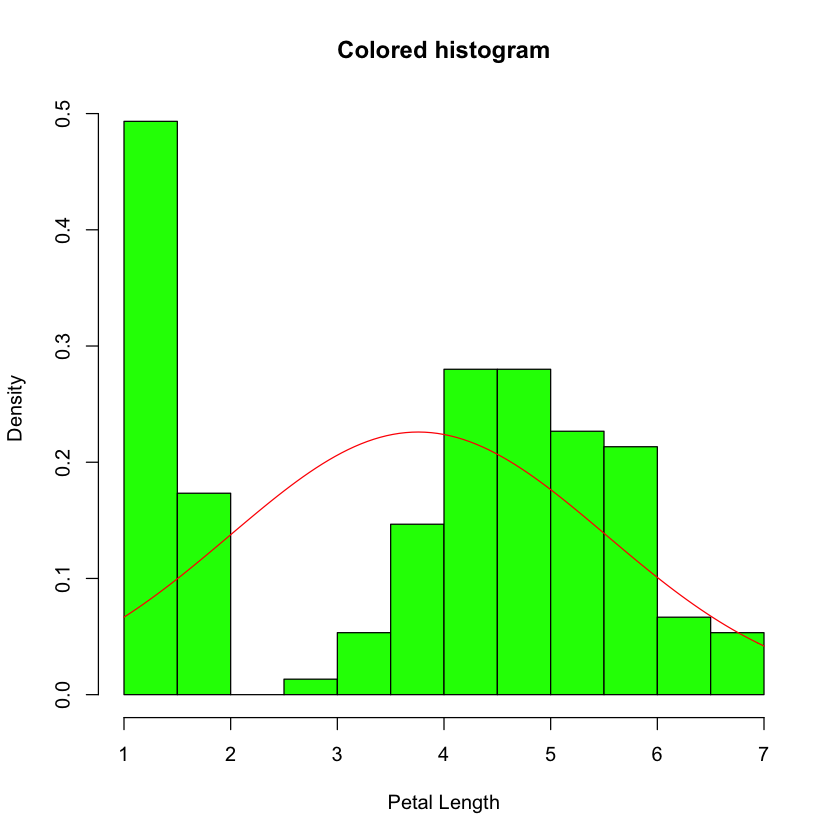

In [33]:
hist(iris$Petal.Length, freq=FALSE, col="green", 
     xlab="Petal Length", main="Colored histogram")
curve(dnorm(x, mean=mean(iris$Petal.Length), 
            sd=sd(iris$Petal.Length)), add=TRUE, col="red") #line

## 4.2 -- ggplot 

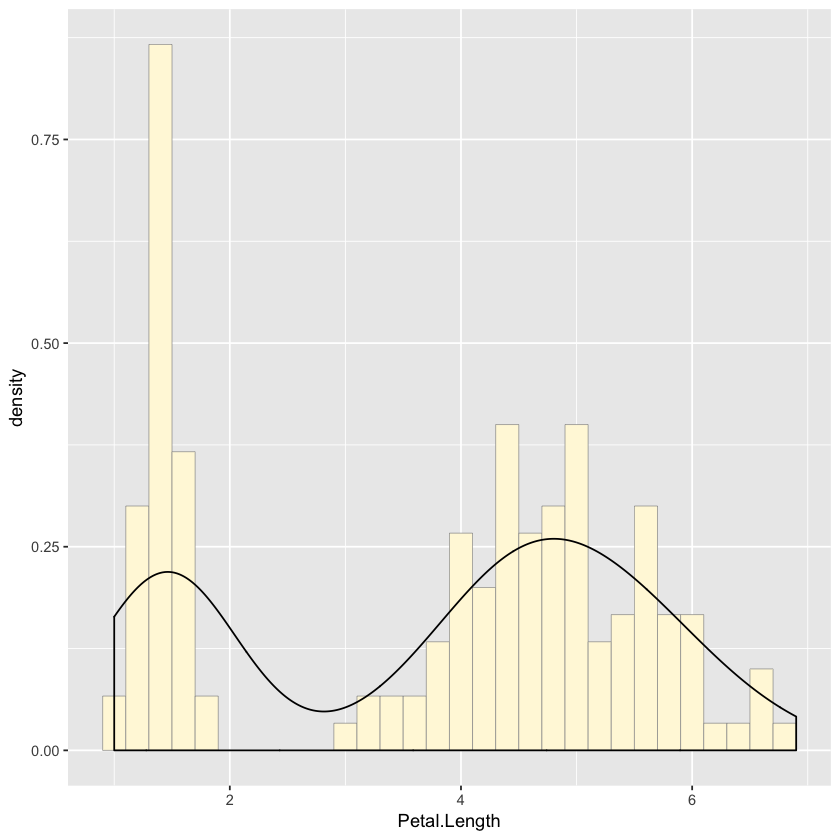

In [34]:
ggplot(iris, aes(x=Petal.Length, y=..density..)) +
  geom_histogram(fill="cornsilk", binwidth=0.2, colour="grey60", size=.2) +
  geom_density() 

## 4.3 -- ggplot overlay 

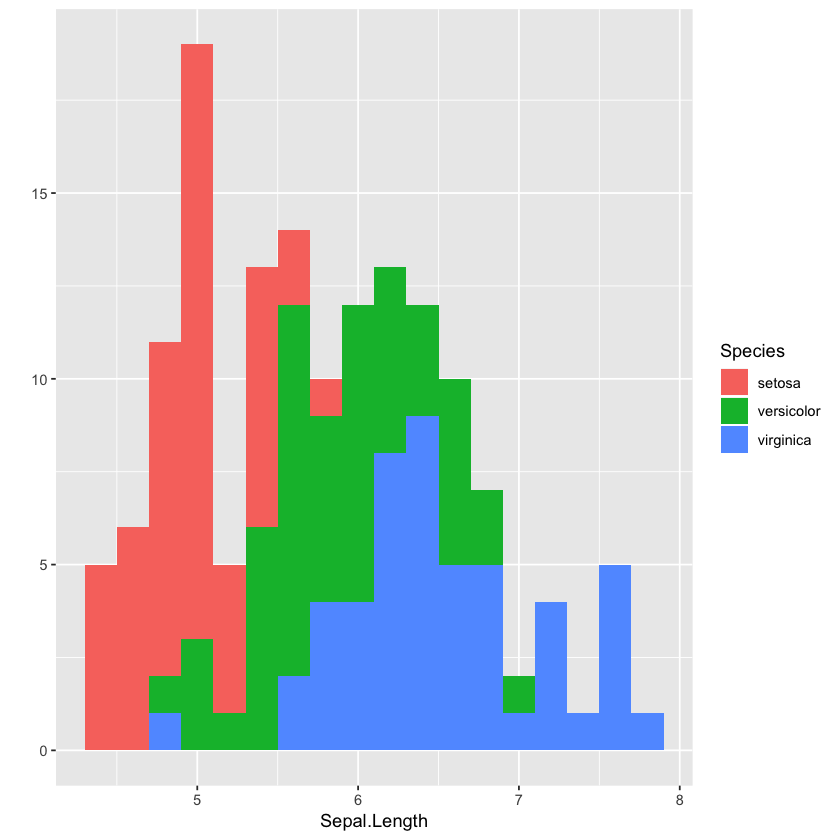

In [35]:
qplot(Sepal.Length, data=iris, geom="histogram", fill=Species, binwidth=0.2)

## 4.3 -- plotly

In [36]:
plot_ly(alpha = 0.6) %>%
 add_histogram(x = ~iris$Petal.Length) %>%
 add_histogram(x = ~iris$Sepal.Length) %>%
 layout(barmode = "overlay")

HTML widgets cannot be represented in plain text (need html)

# 5) ------------------------ Pie Charts ------------------------
## 5.1 -- Base R 

In [37]:
data = c(179718,41370,41914,44280)
pct = (data/sum(data))*100
pct = round(pct,2)
labels = c("Army", "Navy", "Air Force","Marines")
labels = paste(labels,pct, "%")
col = c("purple", "violetred1", "green3","red", "cyan")

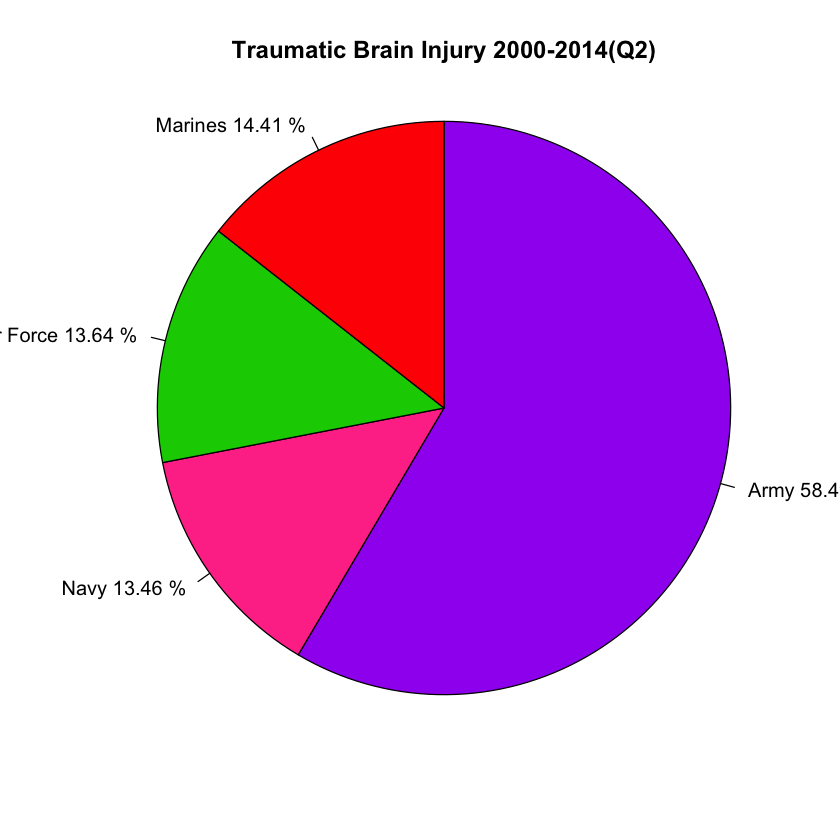

In [38]:
pie(pct,col = col, radius = 1, init.angle = 90, clockwise = TRUE, 
    labels =labels, main = "Traumatic Brain Injury 2000-2014(Q2)")

# 6) ------------------------ Bar Graphs ------------------------
## 6.1 -- Base R 

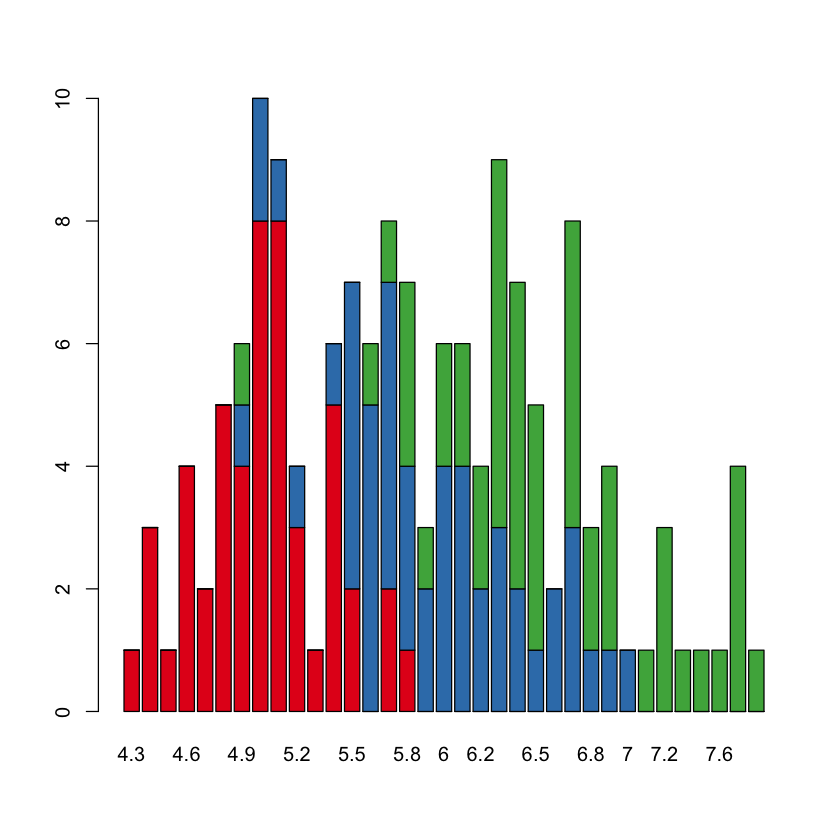

In [39]:
library(RColorBrewer)
barplot(table(iris$Species,iris$Sepal.Length),col  = brewer.pal(3,"Set1")) #Stacked Plot

## 6.2 -- ggplot


Attaching package: ‘reshape2’

The following objects are masked from ‘package:reshape’:

    colsplit, melt, recast



Species,variable,value
setosa,Sepal.Length,5.1
setosa,Sepal.Length,4.9
setosa,Sepal.Length,4.7


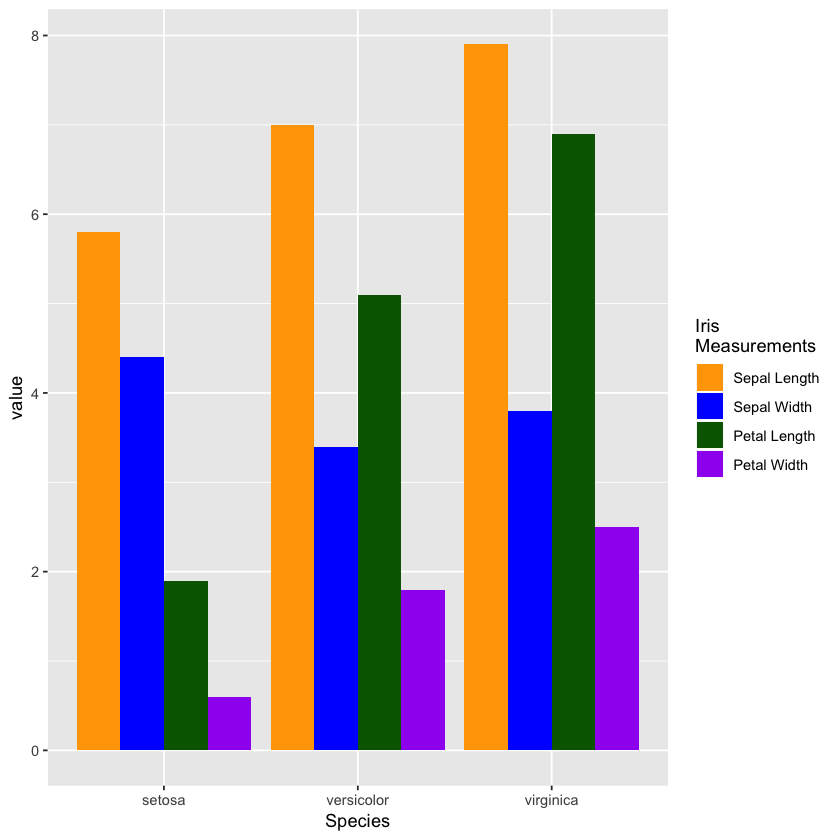

In [40]:
library(reshape2)
iris2 <- melt(iris, id.vars="Species")
iris2[1:3,]
bar1 <- ggplot(data=iris2, aes(x=Species, y=value, fill=variable))
bar1 + geom_bar(stat="identity", position="dodge") + 
  scale_fill_manual(values=c("orange", "blue", "darkgreen", "purple"),
                    name="Iris\nMeasurements",
                    breaks=c("Sepal.Length", "Sepal.Width", "Petal.Length", "Petal.Width"),
                    labels=c("Sepal Length", "Sepal Width", "Petal Length", "Petal Width"))


## 6.2 -- plotly 

In [41]:
plot_ly(iris, x = ~Sepal.Length, y = ~Sepal.Width, type = 'bar', name = 'Sepal.Width') %>%
 add_trace(y = ~Petal.Length, name = 'Petal.Length') %>%
 add_trace(y = ~Petal.Width, name = 'Petal.Width')

HTML widgets cannot be represented in plain text (need html)

## 6.3 -- plotly 

In [42]:
plot_ly(iris, x = ~Sepal.Length, y = ~Sepal.Width, type = 'bar', name = 'Sepal.Width') %>%
 add_trace(y = ~Petal.Length, name = 'Petal.Length') %>%
 add_trace(y = ~Petal.Width, name = 'Petal.Width') %>%
 layout(yaxis = list(title = 'Count'), barmode = 'stack')

HTML widgets cannot be represented in plain text (need html)

# 7) ------------------------ Line Graphs ------------------------
## 7.1 Basic R

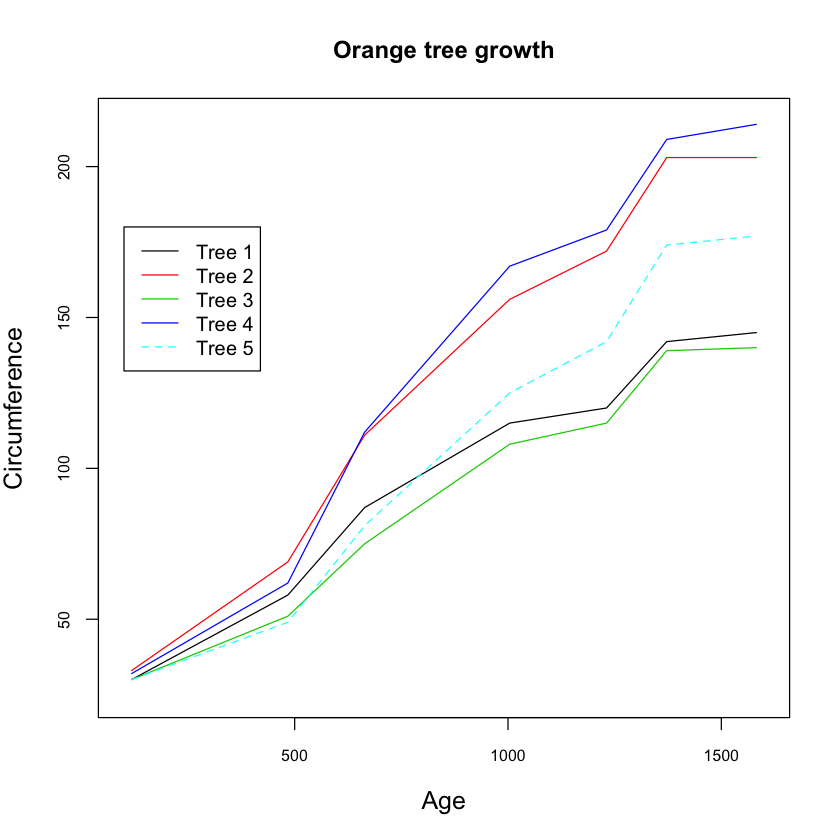

In [43]:
ind1=which(Orange$Tree=="1")
ind2=which(Orange$Tree=="2")
ind3=which(Orange$Tree=="3")
ind4=which(Orange$Tree=="4")
ind5=which(Orange$Tree=="5")
plot(Orange$age[ind1],Orange$circumference[ind1],main="Orange tree growth",
     xlab="Age",ylab="Circumference",type="l",cex.lab=1.25,cex.axis=0.8,xlim=c(100,1600),
     ylim=c(25,215))
lines(Orange$age[ind2],Orange$circumference[ind2],col=2)
lines(Orange$age[ind3],Orange$circumference[ind3],col=3)
lines(Orange$age[ind4],Orange$circumference[ind4],col=4)
lines(Orange$age[ind5],Orange$circumference[ind5],col=5,lty=2)
legend(100,180,legend=c("Tree 1","Tree 2","Tree 3","Tree 4","Tree 5"),col=1:5,lty=c(rep(1,4),2))


## 7.2 ggplot 

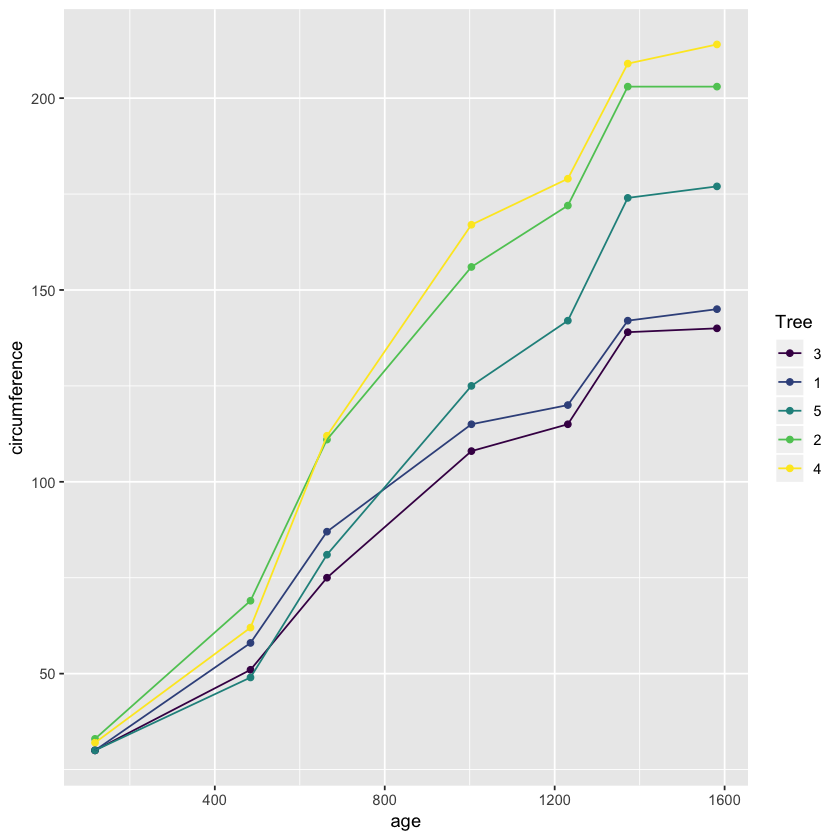

In [44]:
qplot(age, circumference, data = Orange, geom = c("point", "line"), color = Tree)

## 7.3 plotly 

In [45]:
ind1=which(Orange$Tree=="1")
ind2=which(Orange$Tree=="2")
ind3=which(Orange$Tree=="3")
ind4=which(Orange$Tree=="4")
ind5=which(Orange$Tree=="5")
p<- plot_ly(Orange, x = ~age[ind1], y = ~circumference[ind1], name = 'Tree 1', type = 'scatter',
       mode = 'lines') %>%
 add_trace(y = ~circumference[ind2], name = 'Tree 2', mode = 'lines+markers') %>%
 add_trace(y = ~circumference[ind3], name = 'Tree 3', mode = 'lines+markers') %>%
 add_trace(y = ~circumference[ind4], name = 'Tree 4', mode = 'lines+markers') %>%
 add_trace(y = ~circumference[ind5], name = 'Tree 5', mode = 'lines+markers')
p

HTML widgets cannot be represented in plain text (need html)

# 8) ------------------------ Heatmaps ------------------------
## 8.1 one color

In [46]:
nba <- read.csv("http://datasets.flowingdata.com/ppg2008.csv")
nba$Name <- with(nba, reorder(Name, PTS))
# scaling <- function(x) { (x - min(x))/(max(x) - min(x))} 
normed <- as.data.frame(lapply(nba[,-1], rescale)) 
normed$Name <- nba$Name
nba.m <- melt(normed)

Using Name as id variables


In [47]:
head(nba)

Name,G,MIN,PTS,FGM,FGA,FGP,FTM,FTA,FTP,⋯,X3PA,X3PP,ORB,DRB,TRB,AST,STL,BLK,TO,PF
Dwyane Wade,79,38.6,30.2,10.8,22.0,0.491,7.5,9.8,0.765,⋯,3.5,0.317,1.1,3.9,5.0,7.5,2.2,1.3,3.4,2.3
LeBron James,81,37.7,28.4,9.7,19.9,0.489,7.3,9.4,0.780,⋯,4.7,0.344,1.3,6.3,7.6,7.2,1.7,1.1,3.0,1.7
Kobe Bryant,82,36.2,26.8,9.8,20.9,0.467,5.9,6.9,0.856,⋯,4.1,0.351,1.1,4.1,5.2,4.9,1.5,0.5,2.6,2.3
Dirk Nowitzki,81,37.7,25.9,9.6,20.0,0.479,6.0,6.7,0.890,⋯,2.1,0.359,1.1,7.3,8.4,2.4,0.8,0.8,1.9,2.2
Danny Granger,67,36.2,25.8,8.5,19.1,0.447,6.0,6.9,0.878,⋯,6.7,0.404,0.7,4.4,5.1,2.7,1.0,1.4,2.5,3.1
Kevin Durant,74,39.0,25.3,8.9,18.8,0.476,6.1,7.1,0.863,⋯,3.1,0.422,1.0,5.5,6.5,2.8,1.3,0.7,3.0,1.8


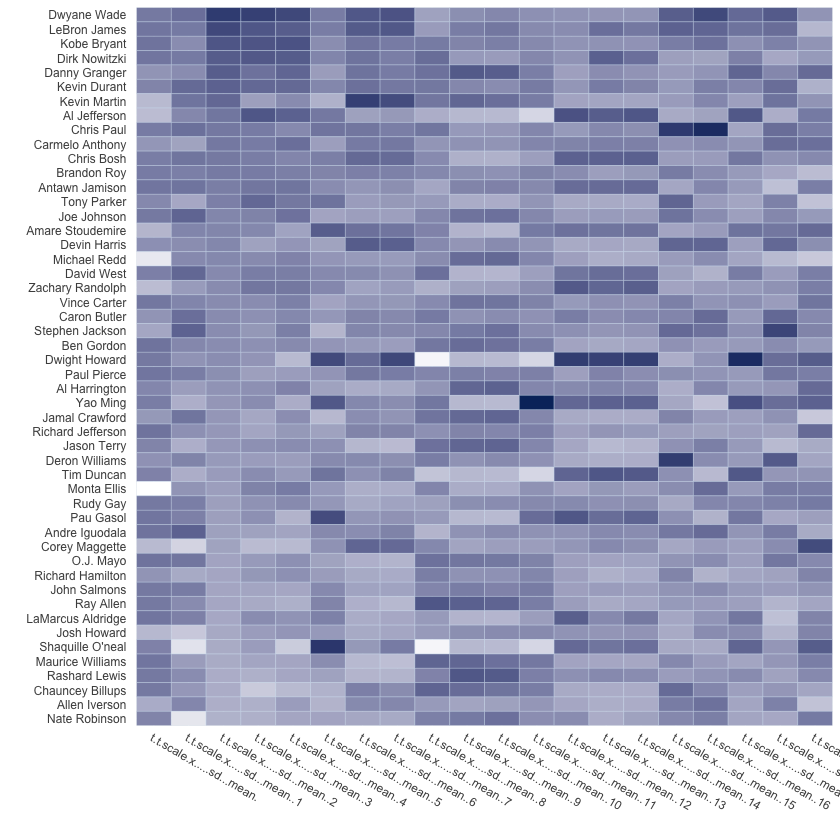

In [48]:
ggplot(nba.m, aes(variable, Name)) + 
  geom_tile(aes(fill = value), colour = "#D3E3F3") + 
  scale_fill_gradient(low = "#FFFFFF", high = "#08306B") + 
  scale_x_discrete("", expand = c(0, 0)) + 
  scale_y_discrete("", expand = c(0, 0)) + 
  theme_grey(base_size = 9) + 
  theme(legend.position = "none",
        axis.ticks = element_blank(), 
        axis.text.x = element_text(angle = 330, hjust = 0))

## # 8.2 multicolor

NOTE: This part runs well in R Studio, but gives an error in Jupyter: feel free to try it out there.

In [49]:
nba.m$Category <- nba.m$variable
levels(nba.m$Category) <- 
  list("Offensive" = c("PTS", "FGM", "FGA", "AST", "X3PM", "X3PA"),
       "Defensive" = c("DRB", "ORB", "TRB","BLK", "PF", "STL"),
       "Other" = c("G", "MIN", "FGP", "FTM", "FTA", "FTP", "X3PP", "TO"))
nba.m$rescaleoffset <- nba.m$value + 100*(as.numeric(nba.m$Category)-1)
scalerange <- range(nba.m$value)
gradientends <- scalerange + rep(c(0,100,200), each=2)

colorends <- c("white", "red", "white", "green", "white", "blue")

In [50]:
# ggplot(nba.m, aes(variable, Name)) + 
#   geom_tile(aes(fill = rescaleoffset), colour = "white") + 
#   scale_fill_gradientn(colours = colorends, values = rescale(gradientends)) + 
#   scale_x_discrete("", expand = c(0, 0)) + 
#   scale_y_discrete("", expand = c(0, 0)) + 
#   theme_grey(base_size = 9) + 
#   theme(legend.position = "none",
#         axis.ticks = element_blank(), 
#         axis.text.x = element_text(angle = 330, hjust = 0))

## 8.3 multicolor ordered 

NOTE: This part runs well in R Studio, but gives an error in Jupyter: feel free to try it out there.

In [51]:
nba.m$variable2 <- reorder(nba.m$variable, as.numeric(nba.m$Category))

In [52]:
# ggplot(nba.m, aes(variable2, Name)) + 
#   geom_tile(aes(fill = rescaleoffset), colour = "white") + 
#   scale_fill_gradientn(colours = colorends, values = rescale(gradientends)) + 
#   scale_x_discrete("", expand = c(0, 0)) + 
#   scale_y_discrete("", expand = c(0, 0)) + 
#   theme_grey(base_size = 9) + 
#   theme(legend.position = "none",
#         axis.ticks = element_blank(), 
#         axis.text.x = element_text(angle = 330, hjust = 0))